<a href="https://colab.research.google.com/github/workwithjahan/MIRA_LAB/blob/main/MIRA_LAB3_mastercopy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 3: Rigid Registration


## Remainder

Among other useful information, it tells you to make a copy of this Colab notebook BEFORE you try to run it:

- Make a copy on your own Colab space by clicking on the `copy to drive` button.
- Alternatively you could go to the menu `File > Save a copy in Drive`
- Then, open your new file on a new tap and rename it, and you’re ready to start tinkering with the code
- Look carefully at the existing code before you execute it. Try to understand what the code is doing. Part of your learning outcome is to understand it, and we will quiz you about it.
- In several places of the code, you’ll find `#__________TO DO_________`.
There you should introduce your code.

Once you are done, submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.

Use `$\color{red}{\text{This is my red text}}$` to write "$\color{red}{\text{This is my red text}}$".

## Goals of this lab
The aim of this lab is to develop competences regarding teamwork and problem solving. By developing the proposed activity you will also become familiar with SIFT and planar transformations for rigid image registration: how to extract invariant features, how to describe them, how to match them and how to use them to compute a homography. Most importantly, this should give you some feeling about the strengths and weaknesses of local feature-based approaches.
It should be noted that before you start this activity, you should read Lowe’s paper on SIFT:

David G. Lowe, "Distinctive image features from scale-invariant keypoints," International Journal of Computer Vision, 60, 2 (2004), pp. 91-110.
The paper can be downloaded from [here](http://www.cs.ubc.ca/~lowe/papers/ijcv04.pdf).

This lab requires working in teams of two (exceptionally three) students. The labs will be organized on the first lab session by the professor who acts as lab instructor.

Students will have to:

1. Test Lowe’s implementation on a set of images showing some skin lesions and compare the obtained results with the provided by a third party library.
2. Register the images pairs corresponding to the same skin lesion using Lowe’s implementation to detect and match features, and implementing different motion models by estimating homography matrices.
3. Improve the registration accuracy by means of data normalization for the homography estimation.

# Loading the required files
You can load into the temporal workspace of Colab the following required files:

*   the data files `LAB3_data`. Download them from Moodle to your computer and uncompress them.

You should copy these files from your computer using the function `files.upload()`. Use the `Choose Files` button to upload both files from your local drive.

Don't use Safari, it is preferable to use google chrome

In [ ]:
from google.colab import files
uploaded = files.upload()

## Additional tools
In this lab, we will also make use of: 
- NumPy, a popular library for scientific computing
- Matplotlib, a popular library for plotting data
- Routines in the aux_utils.py file, which should already be in the local directory
- Opencv
-...

In [ ]:
import math, copy
import numpy as np
from numpy import genfromtxt
import matplotlib.pyplot as plt
plt.style.use('seaborn')
#from aux_utils import plt_house_x, plt_contour_wgrad, plt_gradients, plt_cost_vs_theta1
from google.colab import files
# import time
from IPython import display
from time import sleep
# import opencv
import cv2
from google.colab.patches import cv2_imshow

import pandas as pd
import io

#Import math Library
import math 
import scipy.linalg as linalg

Next, we will load images `00.png`, `01.png`, `02.png` and `03.png`

In [ ]:
img00c = cv2.imread("00.png") 
img01c = cv2.imread("01.png")
img02c = cv2.imread("02.png")
img03c = cv2.imread("03.png")

And the csv files with keypoints

In [ ]:
keypoints_00 = genfromtxt('Keypoints_00.csv', delimiter=',', skip_header = 0)
keypoints_01 = genfromtxt('Keypoints_01.csv', delimiter=',', skip_header = 0)
keypoints_02 = genfromtxt('Keypoints_02.csv', delimiter=',', skip_header = 0)
keypoints_03 = genfromtxt('Keypoints_03.csv', delimiter=',', skip_header = 0)

print(np.shape(keypoints_00))
print(keypoints_00)

Now plot img00c, img01c, img02c, img03c all images using `cv2_imshow` from `opencv`

In [ ]:
plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c)
plt.title('Image 00.png'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c)
plt.title('Image 01.png'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c)
plt.title('Image 02.png'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c)
plt.title('Image 03.png'), plt.xticks([]), plt.yticks([])

Plot Keypoints on images.

In [ ]:
img00c_copy=img00c.copy()
img01c_copy=img01c.copy()
img02c_copy=img02c.copy()
img03c_copy=img03c.copy()

img00c_keypoints=cv2.drawKeypoints(img00c_copy,cv2.KeyPoint.convert(keypoints_00),img00c)
img01c_keypoints=cv2.drawKeypoints(img01c_copy,cv2.KeyPoint.convert(keypoints_01),img01c)
img02c_keypoints=cv2.drawKeypoints(img02c_copy,cv2.KeyPoint.convert(keypoints_02),img02c)
img03c_keypoints=cv2.drawKeypoints(img03c_copy,cv2.KeyPoint.convert(keypoints_03),img03c)

plt.figure(figsize=(30,30))

plt.subplot(411)
plt.imshow(img00c_keypoints)
plt.title('Image 00.png keypoints'), plt.xticks([]), plt.yticks([])

plt.subplot(412)
plt.imshow(img01c_keypoints)
plt.title('Image 01.png keypoints'), plt.xticks([]), plt.yticks([])

plt.subplot(413)
plt.imshow(img02c_keypoints)
plt.title('Image 02.png keypoints'), plt.xticks([]), plt.yticks([])

plt.subplot(414)
plt.imshow(img03c_keypoints)
plt.title('Image 03.png keypoints'), plt.xticks([]), plt.yticks([])

## Compute Homography

Implement the function:

H = computeHomography(features, matches, model)

where model can be ('Euclidean', 'Similarity', 'Affine', 'Porjective')

follow your notes from MIRA lessons, don't use any opencv existing function

In [ ]:
def computeHomography(features, matches, model):
  
  x_i=features[:,0]
  y_i=features[:,1]
  x_i_p=matches[:,0]
  y_i_p=matches[:,1]

  if model=='Euclidean':
    
    A=np.zeros((np.shape(features)[0]*2,4))
    b=np.zeros((np.shape(features)[0]*2,1))
    r=0

    for x,y,x_p,y_p in zip(x_i,y_i,x_i_p,y_i_p):
      
      A[r,0]=x
      A[r,1]=-1*y
      A[r,2]=1
      A[r+1,0]=y
      A[r+1,1]=x
      A[r+1,3]=1
      
      b[r,0]=x_p
      b[r+1,0]=y_p

      r=r+2   

    AT=np.transpose(A)
    x=np.matmul(np.linalg.inv(np.matmul(AT,A)),np.matmul(AT,b))
    H=[ [ float(x[0]), -1*float(x[1]), float(x[2])], [ float(x[1]), float(x[0]), float(x[3])], [0, 0, 1] ]

    s=H[1][0]/np.sin(np.arctan(H[1][0]/H[0][0]))

    H=[ [ float(x[0])/s, -1*float(x[1])/s, float(x[2])], [ float(x[1])/s, float(x[0])/s, float(x[3])], [0, 0, 1] ]

  elif model=='Similarity':
    
    A=np.zeros((np.shape(features)[0]*2,4))
    b=np.zeros((np.shape(features)[0]*2,1))
    r=0

    for x,y,x_p,y_p in zip(x_i,y_i,x_i_p,y_i_p):
      
      A[r,0]=x
      A[r,1]=-1*y
      A[r,2]=1
      A[r+1,0]=y
      A[r+1,1]=x
      A[r+1,3]=1
      
      b[r,0]=x_p
      b[r+1,0]=y_p

      r=r+2   

    AT=np.transpose(A)
    x=np.matmul(np.linalg.inv(np.matmul(AT,A)),np.matmul(AT,b))
    H=[ [ float(x[0]), -1*float(x[1]), float(x[2])], [ float(x[1]), float(x[0]), float(x[3])], [0, 0, 1] ]

    s=H[1][0]/np.sin(np.arctan(H[1][0]/H[0][0]))
   
  
  elif model=='Affine':
    
    A=np.zeros((np.shape(features)[0]*2,6))
    b=np.zeros((np.shape(features)[0]*2,1))
    r=0
    
    for x,y,x_p,y_p in zip(x_i,y_i,x_i_p,y_i_p):
      
      A[r,0]=x
      A[r,1]=y
      A[r,2]=1
      A[r+1,3]=x
      A[r+1,4]=y
      A[r+1,5]=1
      
      b[r,0]=x_p
      b[r+1,0]=y_p

      r=r+2   

    AT=np.transpose(A)
    x=np.matmul(np.linalg.inv(np.matmul(AT,A)),np.matmul(AT,b))
    H_p=np.reshape(x,(2,3))
    H=np.append(H_p,[[0, 0, 1]], axis=0)

  
  elif model=='Projective':
    
    A=np.zeros((np.shape(features)[0]*2,8))
    b=np.zeros((np.shape(features)[0]*2,1))
    r=0

    for x,y,x_p,y_p in zip(x_i,y_i,x_i_p,y_i_p):
      
      A[r,0]=x
      A[r,1]=y
      A[r,2]=1
      A[r,6]=-1*x_p*x
      A[r,7]=-1*x_p*y

      A[r+1,3]=x
      A[r+1,4]=y
      A[r+1,5]=1
      A[r+1,6]=-1*y_p*x
      A[r+1,7]=-1*y_p*y
      
      b[r,0]=x_p
      b[r+1,0]=y_p

      r=r+2   

    # AT=np.transpose(A)
    # x=np.matmul(np.linalg.inv(np.matmul(AT,A)),np.matmul(AT,b))
    # H=[ [ float(x[0]), -1*float(x[1]), float(x[2])], [ float(x[3]), float(x[4]), float(x[5])], [ float(x[6]), float(x[7]), 1] ]

    h_1 = np.linalg.lstsq(A, b)[0]
    h = h_1.flatten()
    # h_2 = np.reshape(h_1, (8, 1))
    h = np.concatenate((h, [1]), axis=-1)
    H = np.reshape(h, (3, 3))

  return np.asarray(H)

##Compute Eucliedean Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

(Text(0.5, 1.0, 'Image 03.png Euclidean Transform with Image 03 as moving'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

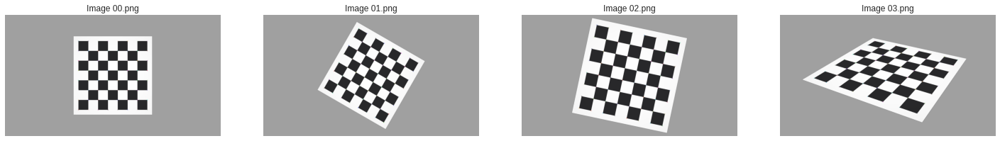

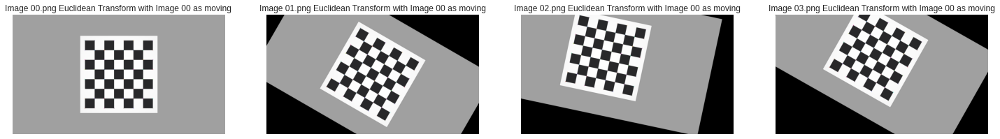

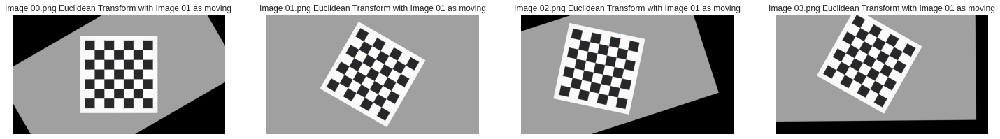

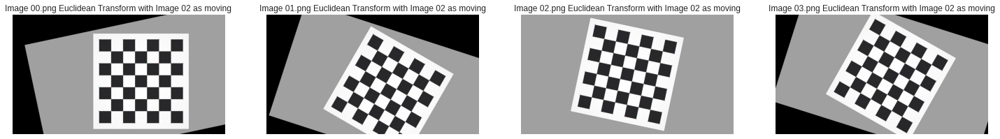

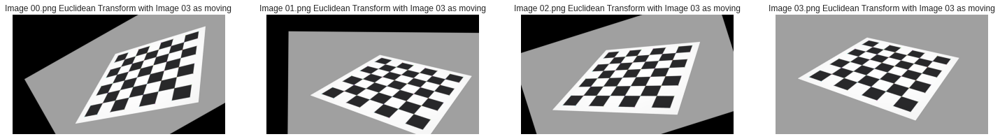

In [ ]:
H_0_0_E = computeHomography(keypoints_00,keypoints_00,'Euclidean')
H_0_1_E = computeHomography(keypoints_00,keypoints_01,'Euclidean')
H_0_2_E = computeHomography(keypoints_00,keypoints_02,'Euclidean')
H_0_3_E = computeHomography(keypoints_00,keypoints_03,'Euclidean')

H_1_0_E = computeHomography(keypoints_01,keypoints_00,'Euclidean')
H_1_1_E = computeHomography(keypoints_01,keypoints_01,'Euclidean')
H_1_2_E = computeHomography(keypoints_01,keypoints_02,'Euclidean')
H_1_3_E = computeHomography(keypoints_01,keypoints_03,'Euclidean')

H_2_0_E = computeHomography(keypoints_02,keypoints_00,'Euclidean')
H_2_1_E = computeHomography(keypoints_02,keypoints_01,'Euclidean')
H_2_2_E = computeHomography(keypoints_02,keypoints_02,'Euclidean')
H_2_3_E = computeHomography(keypoints_02,keypoints_03,'Euclidean')

H_3_0_E = computeHomography(keypoints_03,keypoints_00,'Euclidean')
H_3_1_E = computeHomography(keypoints_03,keypoints_01,'Euclidean')
H_3_2_E = computeHomography(keypoints_03,keypoints_02,'Euclidean')
H_3_3_E = computeHomography(keypoints_03,keypoints_03,'Euclidean')

img00c_0E = cv2.warpPerspective(img00c, H_0_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_0E = cv2.warpPerspective(img00c, H_0_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_0E = cv2.warpPerspective(img00c, H_0_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_0E = cv2.warpPerspective(img00c, H_0_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_1E = cv2.warpPerspective(img01c, H_1_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_1E = cv2.warpPerspective(img01c, H_1_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_1E = cv2.warpPerspective(img01c, H_1_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_1E = cv2.warpPerspective(img01c, H_1_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_2E = cv2.warpPerspective(img02c, H_2_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_2E = cv2.warpPerspective(img02c, H_2_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_2E = cv2.warpPerspective(img02c, H_2_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_2E = cv2.warpPerspective(img02c, H_2_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_3E = cv2.warpPerspective(img03c, H_3_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_3E = cv2.warpPerspective(img03c, H_3_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_3E = cv2.warpPerspective(img03c, H_3_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_3E = cv2.warpPerspective(img03c, H_3_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c)
plt.title('Image 00.png'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c)
plt.title('Image 01.png'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c)
plt.title('Image 02.png'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c)
plt.title('Image 03.png'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_0E)
plt.title('Image 00.png Euclidean Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_0E)
plt.title('Image 01.png Euclidean Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_0E)
plt.title('Image 02.png Euclidean Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_0E)
plt.title('Image 03.png Euclidean Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_1E)
plt.title('Image 00.png Euclidean Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_1E)
plt.title('Image 01.png Euclidean Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_1E)
plt.title('Image 02.png Euclidean Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_1E)
plt.title('Image 03.png Euclidean Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_2E)
plt.title('Image 00.png Euclidean Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_2E)
plt.title('Image 01.png Euclidean Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_2E)
plt.title('Image 02.png Euclidean Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_2E)
plt.title('Image 03.png Euclidean Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_3E)
plt.title('Image 00.png Euclidean Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_3E)
plt.title('Image 01.png Euclidean Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_3E)
plt.title('Image 02.png Euclidean Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_3E)
plt.title('Image 03.png Euclidean Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

In [ ]:
H_3_0_E

array([[ 9.24365575e-01,  2.36516839e+00, -4.75331975e+02],
       [-5.34175912e-01,  2.66242342e+00,  1.34818290e+02],
       [ 9.97398732e-08,  1.31577984e-03,  1.00000000e+00]])

##Compute Similarity Homography
Compute the Similarity Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

(Text(0.5, 1.0, 'Image 03.png SimilarityTransform with Image 03 as moving'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

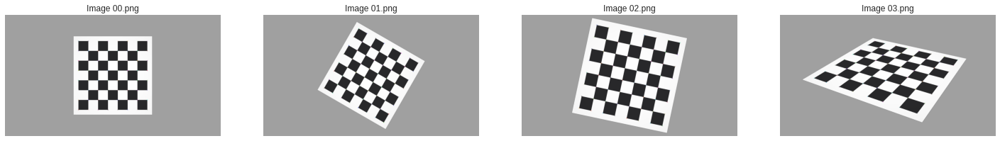

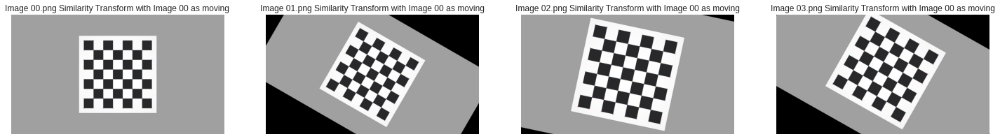

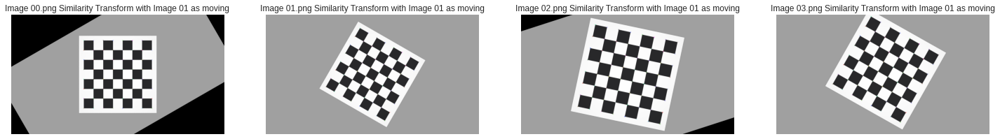

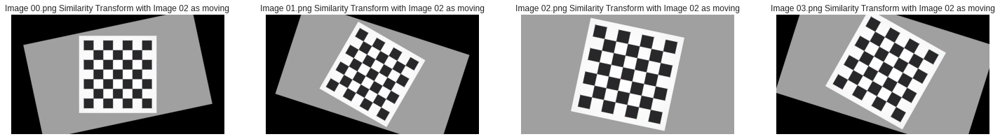

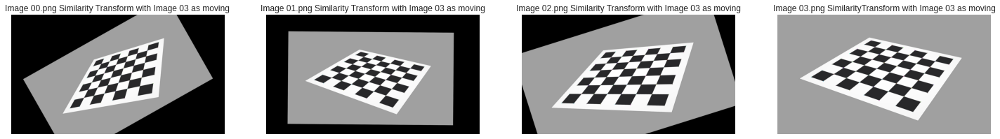

In [ ]:
H_0_0_E = computeHomography(keypoints_00,keypoints_00,'Similarity')
H_0_1_E = computeHomography(keypoints_00,keypoints_01,'Similarity')
H_0_2_E = computeHomography(keypoints_00,keypoints_02,'Similarity')
H_0_3_E = computeHomography(keypoints_00,keypoints_03,'Similarity')

H_1_0_E = computeHomography(keypoints_01,keypoints_00,'Similarity')
H_1_1_E = computeHomography(keypoints_01,keypoints_01,'Similarity')
H_1_2_E = computeHomography(keypoints_01,keypoints_02,'Similarity')
H_1_3_E = computeHomography(keypoints_01,keypoints_03,'Similarity')

H_2_0_E = computeHomography(keypoints_02,keypoints_00,'Similarity')
H_2_1_E = computeHomography(keypoints_02,keypoints_01,'Similarity')
H_2_2_E = computeHomography(keypoints_02,keypoints_02,'Similarity')
H_2_3_E = computeHomography(keypoints_02,keypoints_03,'Similarity')

H_3_0_E = computeHomography(keypoints_03,keypoints_00,'Similarity')
H_3_1_E = computeHomography(keypoints_03,keypoints_01,'Similarity')
H_3_2_E = computeHomography(keypoints_03,keypoints_02,'Similarity')
H_3_3_E = computeHomography(keypoints_03,keypoints_03,'Similarity')

img00c_0E = cv2.warpPerspective(img00c, H_0_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_0E = cv2.warpPerspective(img00c, H_0_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_0E = cv2.warpPerspective(img00c, H_0_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_0E = cv2.warpPerspective(img00c, H_0_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_1E = cv2.warpPerspective(img01c, H_1_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_1E = cv2.warpPerspective(img01c, H_1_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_1E = cv2.warpPerspective(img01c, H_1_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_1E = cv2.warpPerspective(img01c, H_1_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_2E = cv2.warpPerspective(img02c, H_2_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_2E = cv2.warpPerspective(img02c, H_2_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_2E = cv2.warpPerspective(img02c, H_2_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_2E = cv2.warpPerspective(img02c, H_2_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_3E = cv2.warpPerspective(img03c, H_3_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_3E = cv2.warpPerspective(img03c, H_3_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_3E = cv2.warpPerspective(img03c, H_3_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_3E = cv2.warpPerspective(img03c, H_3_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c)
plt.title('Image 00.png'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c)
plt.title('Image 01.png'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c)
plt.title('Image 02.png'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c)
plt.title('Image 03.png'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_0E)
plt.title('Image 00.png Similarity Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_0E)
plt.title('Image 01.png Similarity Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_0E)
plt.title('Image 02.png Similarity Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_0E)
plt.title('Image 03.png Similarity Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_1E)
plt.title('Image 00.png Similarity Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_1E)
plt.title('Image 01.png Similarity Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_1E)
plt.title('Image 02.png Similarity Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_1E)
plt.title('Image 03.png Similarity Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_2E)
plt.title('Image 00.png Similarity Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_2E)
plt.title('Image 01.png Similarity Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_2E)
plt.title('Image 02.png Similarity Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_2E)
plt.title('Image 03.png Similarity Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_3E)
plt.title('Image 00.png Similarity Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_3E)
plt.title('Image 01.png Similarity Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_3E)
plt.title('Image 02.png Similarity Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_3E)
plt.title('Image 03.png SimilarityTransform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

##Compute Affine Homography

Compute the Affine Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

(Text(0.5, 1.0, 'Image 03.png Affine Transform with Image 03 as moving'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

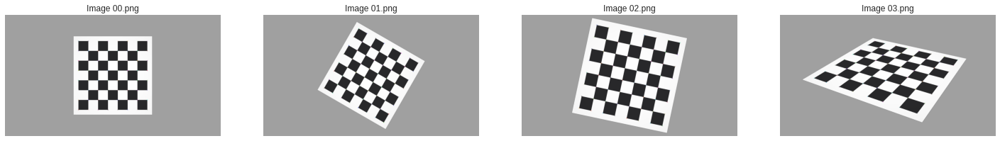

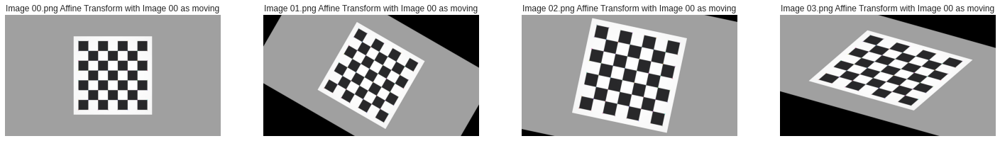

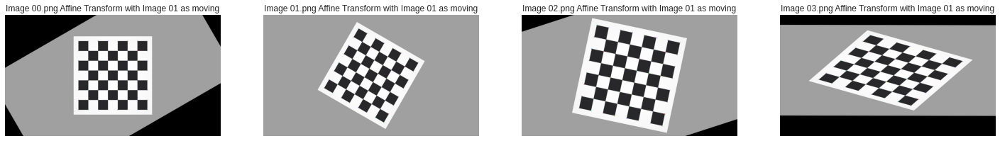

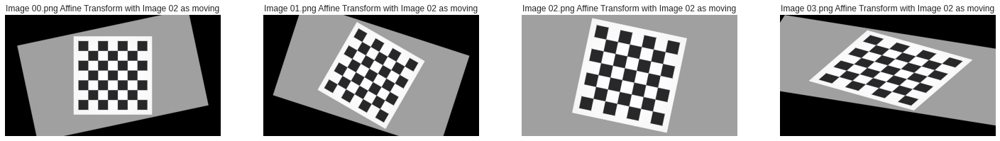

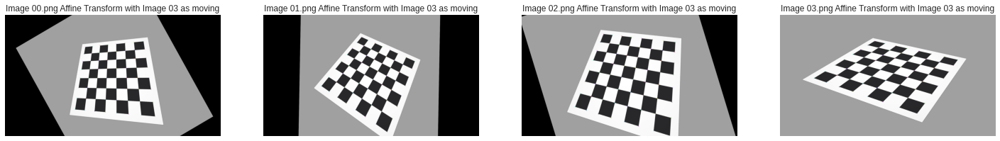

In [ ]:
H_0_0_E = computeHomography(keypoints_00,keypoints_00,'Affine')
H_0_1_E = computeHomography(keypoints_00,keypoints_01,'Affine')
H_0_2_E = computeHomography(keypoints_00,keypoints_02,'Affine')
H_0_3_E = computeHomography(keypoints_00,keypoints_03,'Affine')

H_1_0_E = computeHomography(keypoints_01,keypoints_00,'Affine')
H_1_1_E = computeHomography(keypoints_01,keypoints_01,'Affine')
H_1_2_E = computeHomography(keypoints_01,keypoints_02,'Affine')
H_1_3_E = computeHomography(keypoints_01,keypoints_03,'Affine')

H_2_0_E = computeHomography(keypoints_02,keypoints_00,'Affine')
H_2_1_E = computeHomography(keypoints_02,keypoints_01,'Affine')
H_2_2_E = computeHomography(keypoints_02,keypoints_02,'Affine')
H_2_3_E = computeHomography(keypoints_02,keypoints_03,'Affine')

H_3_0_E = computeHomography(keypoints_03,keypoints_00,'Affine')
H_3_1_E = computeHomography(keypoints_03,keypoints_01,'Affine')
H_3_2_E = computeHomography(keypoints_03,keypoints_02,'Affine')
H_3_3_E = computeHomography(keypoints_03,keypoints_03,'Affine')

img00c_0E = cv2.warpPerspective(img00c, H_0_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_0E = cv2.warpPerspective(img00c, H_0_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_0E = cv2.warpPerspective(img00c, H_0_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_0E = cv2.warpPerspective(img00c, H_0_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_1E = cv2.warpPerspective(img01c, H_1_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_1E = cv2.warpPerspective(img01c, H_1_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_1E = cv2.warpPerspective(img01c, H_1_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_1E = cv2.warpPerspective(img01c, H_1_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_2E = cv2.warpPerspective(img02c, H_2_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_2E = cv2.warpPerspective(img02c, H_2_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_2E = cv2.warpPerspective(img02c, H_2_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_2E = cv2.warpPerspective(img02c, H_2_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_3E = cv2.warpPerspective(img03c, H_3_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_3E = cv2.warpPerspective(img03c, H_3_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_3E = cv2.warpPerspective(img03c, H_3_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_3E = cv2.warpPerspective(img03c, H_3_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c)
plt.title('Image 00.png'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c)
plt.title('Image 01.png'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c)
plt.title('Image 02.png'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c)
plt.title('Image 03.png'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_0E)
plt.title('Image 00.png Affine Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_0E)
plt.title('Image 01.png Affine Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_0E)
plt.title('Image 02.png Affine Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_0E)
plt.title('Image 03.png Affine Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_1E)
plt.title('Image 00.png Affine Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_1E)
plt.title('Image 01.png Affine Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_1E)
plt.title('Image 02.png Affine Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_1E)
plt.title('Image 03.png Affine Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_2E)
plt.title('Image 00.png Affine Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_2E)
plt.title('Image 01.png Affine Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_2E)
plt.title('Image 02.png Affine Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_2E)
plt.title('Image 03.png Affine Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_3E)
plt.title('Image 00.png Affine Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_3E)
plt.title('Image 01.png Affine Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_3E)
plt.title('Image 02.png Affine Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_3E)
plt.title('Image 03.png Affine Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

##Compute Projective Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:118: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


(Text(0.5, 1.0, 'Image 03.png Projective Transform with Image 03 as moving'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

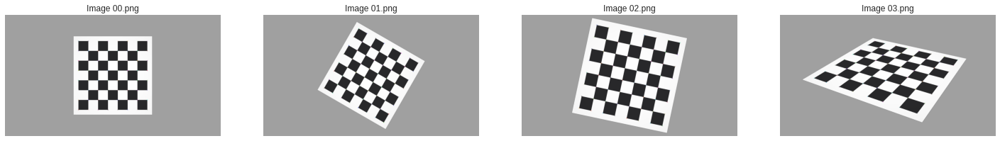

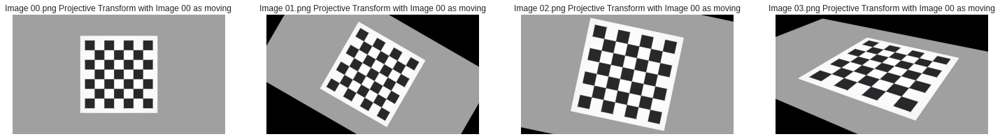

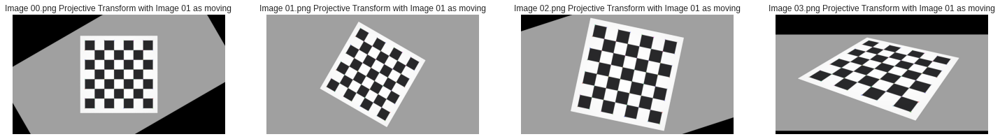

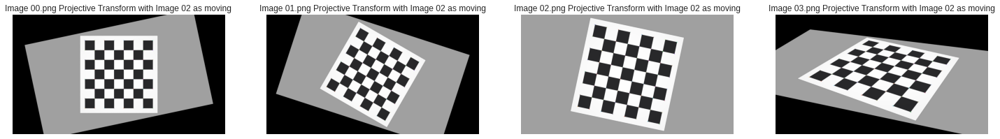

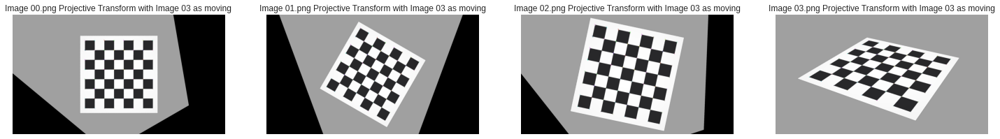

In [ ]:
H_0_0_E = computeHomography(keypoints_00,keypoints_00,'Projective')
H_0_1_E = computeHomography(keypoints_00,keypoints_01,'Projective')
H_0_2_E = computeHomography(keypoints_00,keypoints_02,'Projective')
H_0_3_E = computeHomography(keypoints_00,keypoints_03,'Projective')

H_1_0_E = computeHomography(keypoints_01,keypoints_00,'Projective')
H_1_1_E = computeHomography(keypoints_01,keypoints_01,'Projective')
H_1_2_E = computeHomography(keypoints_01,keypoints_02,'Projective')
H_1_3_E = computeHomography(keypoints_01,keypoints_03,'Projective')

H_2_0_E = computeHomography(keypoints_02,keypoints_00,'Projective')
H_2_1_E = computeHomography(keypoints_02,keypoints_01,'Projective')
H_2_2_E = computeHomography(keypoints_02,keypoints_02,'Projective')
H_2_3_E = computeHomography(keypoints_02,keypoints_03,'Projective')

H_3_0_E = computeHomography(keypoints_03,keypoints_00,'Projective')
H_3_1_E = computeHomography(keypoints_03,keypoints_01,'Projective')
H_3_2_E = computeHomography(keypoints_03,keypoints_02,'Projective')
H_3_3_E = computeHomography(keypoints_03,keypoints_03,'Projective')

img00c_0E = cv2.warpPerspective(img00c, H_0_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_0E = cv2.warpPerspective(img00c, H_0_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_0E = cv2.warpPerspective(img00c, H_0_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_0E = cv2.warpPerspective(img00c, H_0_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_1E = cv2.warpPerspective(img01c, H_1_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_1E = cv2.warpPerspective(img01c, H_1_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_1E = cv2.warpPerspective(img01c, H_1_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_1E = cv2.warpPerspective(img01c, H_1_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_2E = cv2.warpPerspective(img02c, H_2_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_2E = cv2.warpPerspective(img02c, H_2_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_2E = cv2.warpPerspective(img02c, H_2_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_2E = cv2.warpPerspective(img02c, H_2_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

img00c_3E = cv2.warpPerspective(img03c, H_3_0_E, (1920,1080), flags=cv2.INTER_LINEAR)
img01c_3E = cv2.warpPerspective(img03c, H_3_1_E, (1920,1080), flags=cv2.INTER_LINEAR)
img02c_3E = cv2.warpPerspective(img03c, H_3_2_E, (1920,1080), flags=cv2.INTER_LINEAR)
img03c_3E = cv2.warpPerspective(img03c, H_3_3_E, (1920,1080), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c)
plt.title('Image 00.png'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c)
plt.title('Image 01.png'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c)
plt.title('Image 02.png'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c)
plt.title('Image 03.png'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_0E)
plt.title('Image 00.png Projective Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_0E)
plt.title('Image 01.png Projective Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_0E)
plt.title('Image 02.png Projective Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_0E)
plt.title('Image 03.png Projective Transform with Image 00 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_1E)
plt.title('Image 00.png Projective Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_1E)
plt.title('Image 01.png Projective Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_1E)
plt.title('Image 02.png Projective Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_1E)
plt.title('Image 03.png Projective Transform with Image 01 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_2E)
plt.title('Image 00.png Projective Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_2E)
plt.title('Image 01.png Projective Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_2E)
plt.title('Image 02.png Projective Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_2E)
plt.title('Image 03.png Projective Transform with Image 02 as moving'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(141)
plt.imshow(img00c_3E)
plt.title('Image 00.png Projective Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(142)
plt.imshow(img01c_3E)
plt.title('Image 01.png Projective Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(143)
plt.imshow(img02c_3E)
plt.title('Image 02.png Projective Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

plt.subplot(144)
plt.imshow(img03c_3E)
plt.title('Image 03.png Projective Transform with Image 03 as moving'), plt.xticks([]), plt.yticks([])

##Comment the previous obtained results.

Which is the best homography for each image pair? Why?

$\color{red}{\text{
As in these images the features were very distinct, either one or more than one of the models worked perfectly in transforming the images.}}$

$\color{red}{\text{Using the image img00c as the fixed image and the other three as the moving images, for the transformation of image img01c,
since the transformation is only roation and transformation, using only euclidean homography with 3 DOF was sufficient, though all the other homographies worked as well. In the Euclidean case, only transformation of images img00c and img01c to each other succeeded, while for the other images the Euclidean homography did not work since img02c and img03c involved scaling and projection.}}$

$\color{red}{\text{For transforming img00c to img02c, Similarity transformation was enough, and affine and projective also worked. This is because in similarity, scaling is taken into account. So while euclidean homography successfully rotated the image, the scaling was not applied, and the similarity case was required. Transforming image img03c to the other 3 images, and transformation of the other 3 images to img03c failed using similarity homography, since img03c as the only one that involved projection, and this was a case that the similarity transformation cannot solve.}}$

$\color{red}{\text{The affine homography applied shearing, so transformation of img03c to the other 3 images and vice versa worked partially. For transformation of the other 3 images to each other, affine homography worked successfully, similar to the similarity homography.}}$

$\color{red}{\text{Transforming img00c, img01c, and img02c into img03c and vice versa worked the best with projective homography, and was successful to some extent using affine. In affine, shearing is applied, so the image img03c was sheared, however, the parallel lines were still parallel. This was rectified using projective transformation which implemented the warping caused by camera perspective.}}$

$\color{red}{\text{Therefore, for each image, the homography that worked the best are listed, as there were multiple homographies that were suitable for many of the images:}}$

$\color{red}{\text{img00c: Euclidean, Similarity, Affine, and Projective}}$

$\color{red}{\text{img01c: Euclidean, Similarity, Affine, and Projective}}$

$\color{red}{\text{img02c: Similarity, Affine, and Projective}}$

$\color{red}{\text{img03c: Projective}}$

## Detect SIFT Keypoints and Descriptors
Now we will register real images.

Register skin1.jpg with skin2.jpg

First, load and show the images.

Also set SIFT to detect keypoints on images

$\color{yellow}{\text{To be done during 1st lab session}}$

(Text(0.5, 1.0, 'skin2.jpg'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

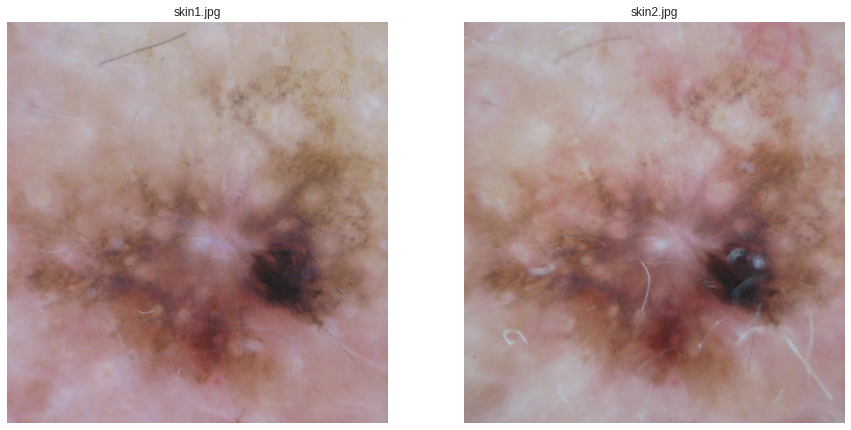

In [ ]:
skin1 = cv2.imread("skin1.jpg") 
skin2 = cv2.imread("skin2.jpg")

plt.figure(figsize=(15,15))

plt.subplot(121)
plt.imshow(cv2.cvtColor(skin1, cv2.COLOR_BGR2RGB))
plt.title('skin1.jpg'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(skin2, cv2.COLOR_BGR2RGB))
plt.title('skin2.jpg'), plt.xticks([]), plt.yticks([])

In [ ]:
sift = cv2.xfeatures2d.SIFT_create()

skin1_gray = cv2.cvtColor(skin1, cv2.COLOR_BGR2GRAY)
skin2_gray = cv2.cvtColor(skin2, cv2.COLOR_BGR2GRAY)

keypoints1, descriptors1 = sift.detectAndCompute(skin1_gray,None)
keypoints2, descriptors2 = sift.detectAndCompute(skin2_gray,None)

# keypoints1 = sift.detectAndCompute(skin1_gray,None)
# keypoints2 = sift.detectAndCompute(skin2_gray,None)

print(np.shape(keypoints1))
print(keypoints1)
print(np.shape(keypoints2))
print(keypoints2)

(72,)
(< cv2.KeyPoint 0x7f4fbc540240>, < cv2.KeyPoint 0x7f4fbc540270>, < cv2.KeyPoint 0x7f4fbc540b10>, < cv2.KeyPoint 0x7f4fbc5407b0>, < cv2.KeyPoint 0x7f4fbc5e8330>, < cv2.KeyPoint 0x7f4fbc2b1f00>, < cv2.KeyPoint 0x7f4fc25848d0>, < cv2.KeyPoint 0x7f4fbc160de0>, < cv2.KeyPoint 0x7f4fbc160ed0>, < cv2.KeyPoint 0x7f4fbc160900>, < cv2.KeyPoint 0x7f4fbc160990>, < cv2.KeyPoint 0x7f4fbc160ba0>, < cv2.KeyPoint 0x7f4fbc160c90>, < cv2.KeyPoint 0x7f4fbc160780>, < cv2.KeyPoint 0x7f4fbc160c60>, < cv2.KeyPoint 0x7f4fbc160c00>, < cv2.KeyPoint 0x7f4fbc160f30>, < cv2.KeyPoint 0x7f4fbf680900>, < cv2.KeyPoint 0x7f4fbf680870>, < cv2.KeyPoint 0x7f4fbf680090>, < cv2.KeyPoint 0x7f4fbf680060>, < cv2.KeyPoint 0x7f4fbf680480>, < cv2.KeyPoint 0x7f4fbf680360>, < cv2.KeyPoint 0x7f4fbf680210>, < cv2.KeyPoint 0x7f4fbf6807b0>, < cv2.KeyPoint 0x7f4fbf6800c0>, < cv2.KeyPoint 0x7f4fbf680f30>, < cv2.KeyPoint 0x7f4fbf6808d0>, < cv2.KeyPoint 0x7f4fbf680270>, < cv2.KeyPoint 0x7f4fbf680990>, < cv2.KeyPoint 0x7f4fbc3a7330>, <

## Plot the Keypoints
$\color{yellow}{\text{To be done during 1st lab session}}$

(Text(0.5, 1.0, 'skin2.jpg keypoints'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

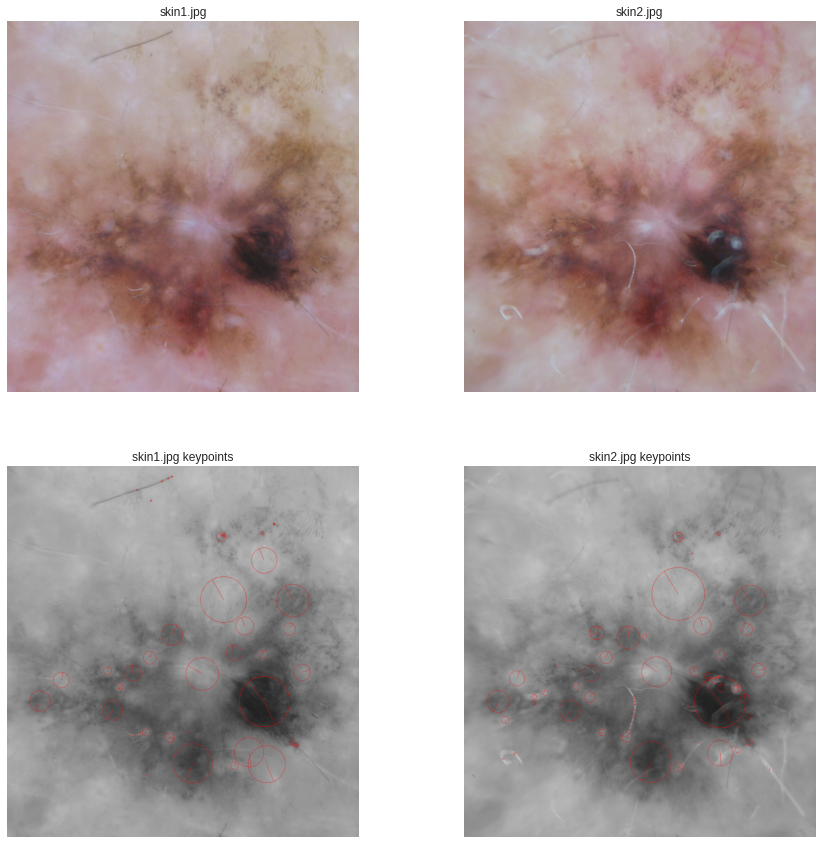

In [ ]:
skin1_keypoints=skin1.copy()
skin1_keypoints=cv2.drawKeypoints(skin1_gray,keypoints1,0,(0, 0, 255),flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

skin2_keypoints=skin2.copy()
skin2_keypoints=cv2.drawKeypoints(skin2_gray,keypoints2,0,(0, 0, 255),flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(15,15))

plt.subplot(221)
plt.imshow(cv2.cvtColor(skin1, cv2.COLOR_BGR2RGB))
plt.title('skin1.jpg'), plt.xticks([]), plt.yticks([])

plt.subplot(222)
plt.imshow(cv2.cvtColor(skin2, cv2.COLOR_BGR2RGB))
plt.title('skin2.jpg'), plt.xticks([]), plt.yticks([])

plt.subplot(223)
plt.imshow(cv2.cvtColor(skin1_keypoints, cv2.COLOR_BGR2RGB))
plt.title('skin1.jpg keypoints'), plt.xticks([]), plt.yticks([])

plt.subplot(224)
plt.imshow(cv2.cvtColor(skin2_keypoints, cv2.COLOR_BGR2RGB))
plt.title('skin2.jpg keypoints'), plt.xticks([]), plt.yticks([])

## Compute Brute Force Matching

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
bf = cv2.BFMatcher()
matches = bf.knnMatch(descriptors1,descriptors2,k=2)

Plot matches

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
img_bf_match = cv2.drawMatchesKnn(skin1_gray, keypoints1, skin2_gray, keypoints2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


In [ ]:
# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

img_good_match= cv2.drawMatchesKnn(skin1_gray, keypoints1, skin2_gray, keypoints2,good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

$\color{red}{\text{We also plotted the Brute Force Matching with the good matches.}}$

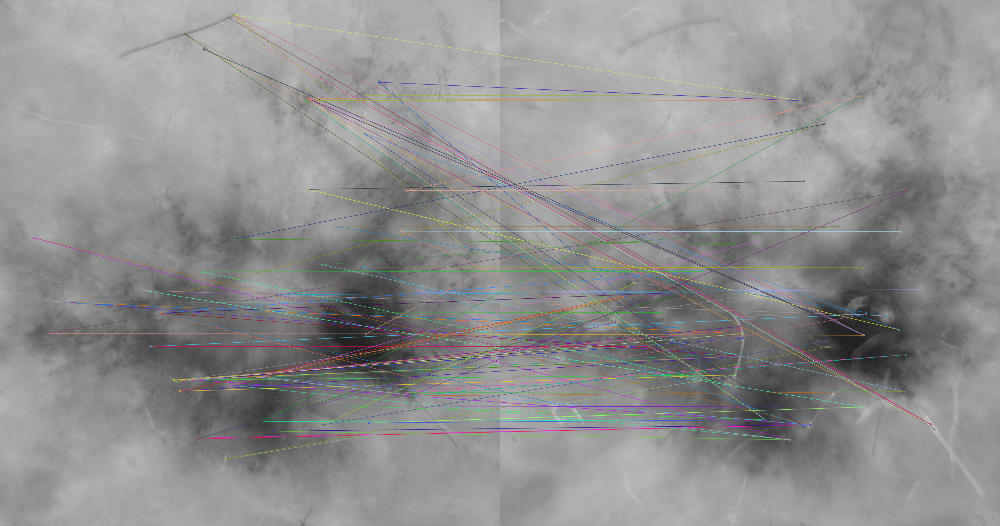

In [ ]:
cv2_imshow(img_bf_match)

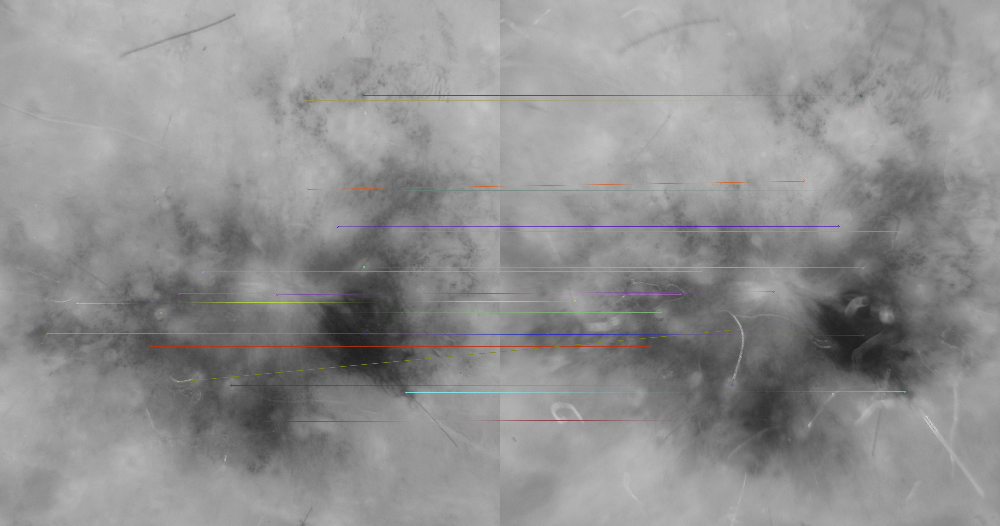

In [ ]:
cv2_imshow(img_good_match)

## Lowe match

Now implement by yourself a function to match keypoints and descriptors between these 2 images

Implement the function `SIFT_match` following the article "Distinctive image features from scale-invariant keypoints" David G. Lowe.

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
from numpy import linalg as LA

In [ ]:
def SIFT_match(feats1, feats2, ratio=0.8):
  
  idxs1, idxs2 = [], []
  matches = []
  distanceL=[]
  for i, feat in enumerate(feats1):
    distances = LA.norm(feats2-feat, axis=1)
    nn = np.argsort(distances)[:2]
    dist1, dist2 = distances[nn[0]], distances[nn[1]]
    
    if dist1/max(1e-6, dist2) < ratio:
      idxs1.append(i)
      idxs2.append(nn[0])
      
  
  for idx1, idx2 in zip(idxs1,idxs2):
  
    distanceL.append(LA.norm(feats2[idx2]-feats1[idx1]))
    matches.append([cv2.DMatch(_imgIdx=0, _queryIdx=idx1, _trainIdx=idx2,_distance=LA.norm(feats2[idx2]-feats1[idx1]))])
    
  return idxs1, idxs2, distanceL, matches

Recompute the matches using your function

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
idxs1, idxs2, distanceL,lowe_matches = SIFT_match(descriptors1,descriptors2)

best_match= [cv2.DMatch(_imgIdx=0,_queryIdx=id1, _trainIdx=id2,_distance=d) for id1, id2 , d in zip(idxs1, idxs2, distanceL)]

Plot the new matches

$\color{yellow}{\text{To be done during 1st lab session}}$

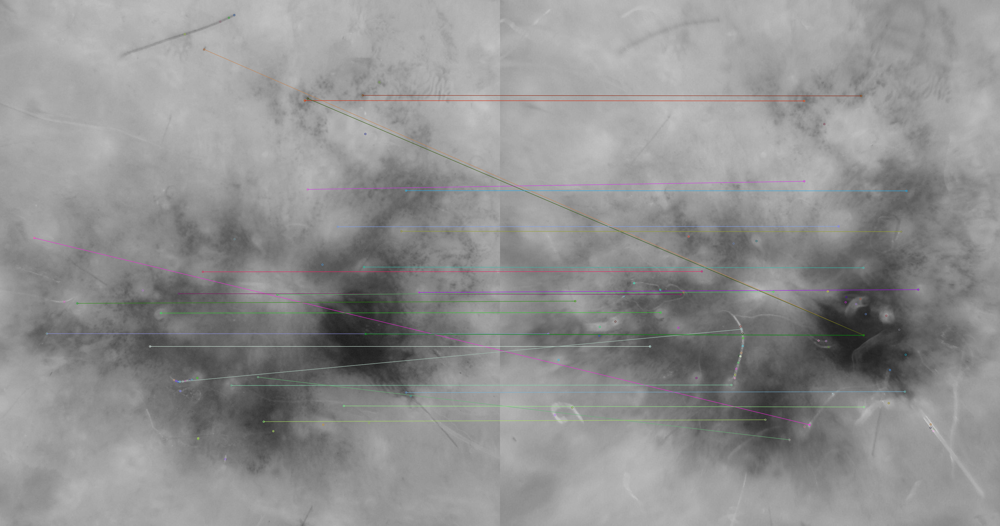

In [ ]:
out_img=np.array([])

out_img = cv2.drawMatches(skin1_gray, keypoints1, 
                                    skin2_gray, keypoints2,
                                    matches1to2=best_match,outImg=out_img)
                                    
cv2_imshow(out_img )

$\color{red}{\text{In **SIFT_match()** function we implemented lowe's keypoint matching in accordance with the "Distinctive image features from scale-invariant }}$
$\color{red}{\text{ keypoints"paper. The function mainly takes descriptors of the two respective skin images as an input. The lowe's ratio of 0.8 value is used to compare}}$ 
$\color{red}{\text{ the distance ratio of closest neighbour.  All matches greater than 0.8 ratio are discarded. The function will output the indexes, the distance of each matches.}}$

## Compute Homographies

Compute the homography between both images using opencv function `cv2.findHomography`

Plot one of the images warped acording to the obtained Homograhy

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
good_points=[]
 
for m, n in matches:
    #append the points according
    #to distance of descriptors
    if(m.distance < 0.6*n.distance):
        good_points.append(m)

without RANSAC

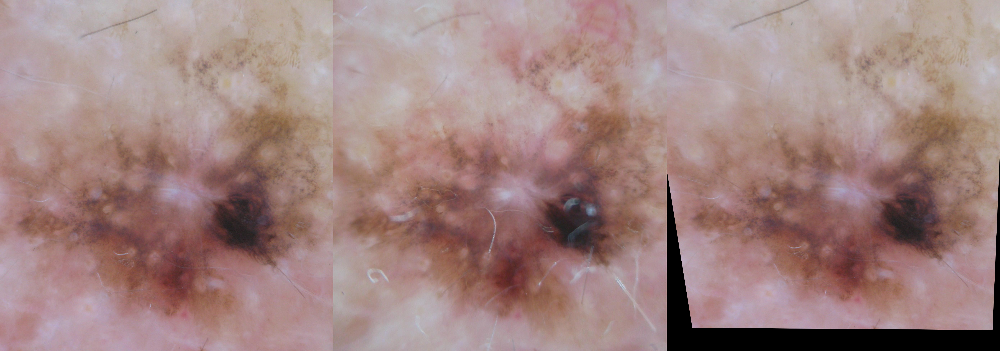

-1

In [ ]:
#without RANSAC

# Read source image.
im_src = cv2.imread('skin1.jpg')
# Four corners of the book in source image

pts_src= np.float32([keypoints1[m.queryIdx]
                 .pt for m in good_points]).reshape(-1, 1, 2)
# Read destination image.
im_dst = cv2.imread('skin2.jpg')
pts_dst=np.float32([keypoints2[m.trainIdx]
                 .pt for m in good_points]).reshape(-1, 1, 2)
# Calculate Homography
h, status = cv2.findHomography(pts_src, pts_dst) 

# Warp source image to destination based on homography
im_out = cv2.warpPerspective(im_src, h, (im_dst.shape[1],im_dst.shape[0]))

# Display images
con=cv2.hconcat((im_src,im_dst,im_out))
cv2_imshow(con)
cv2.waitKey(0)

$\color{red}{\text{Computing homography with ccv2.findHomography function}}$

With RANSAC

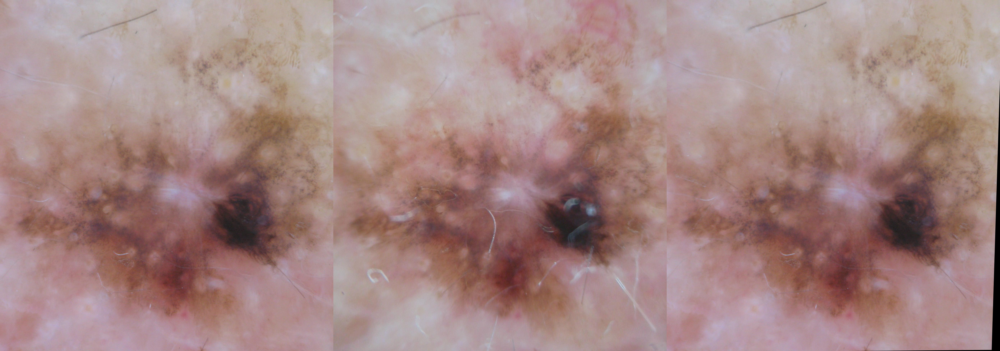

-1

In [ ]:
im_src1 = cv2.imread('skin1.jpg')
# Four corners of the book in source image

pts_src1= np.float32([keypoints1[m.queryIdx]
                 .pt for m in good_points]).reshape(-1, 1, 2)
# Read destination image.
im_dst1 = cv2.imread('skin2.jpg')
pts_dst1=np.float32([keypoints2[m.trainIdx]
                 .pt for m in good_points]).reshape(-1, 1, 2)
# Calculate Homography
h1, status1 = cv2.findHomography(pts_src1, pts_dst1,cv2.RANSAC,1.0) 

# Warp source image to destination based on homography
im_out1 = cv2.warpPerspective(im_src1, h1, (im_dst1.shape[1],im_dst1.shape[0]))

# Display images
con1=cv2.hconcat((im_src1,im_dst1,im_out1))
cv2_imshow(con1)
cv2.waitKey(0)


$\color{red}{\text{Computing homography with cv2.findHomography function with RANSAC . }}$
$\color{red}{\text{Here we can see that with homography the result is improved.}}$

Now Compute the Homography between both images using your Homography Computation function. Use all models and and compare the results

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:118: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


(Text(0.5, 1.0, 'skin image 2 Projective'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

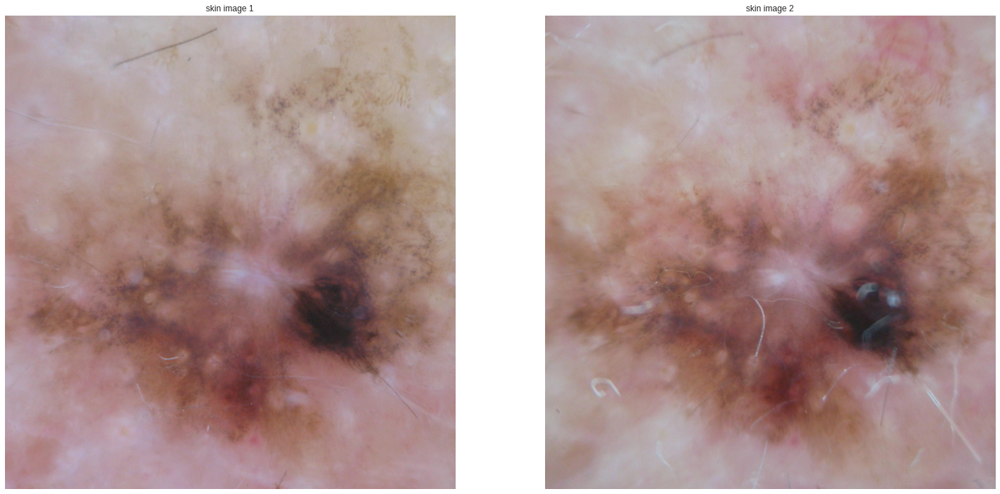

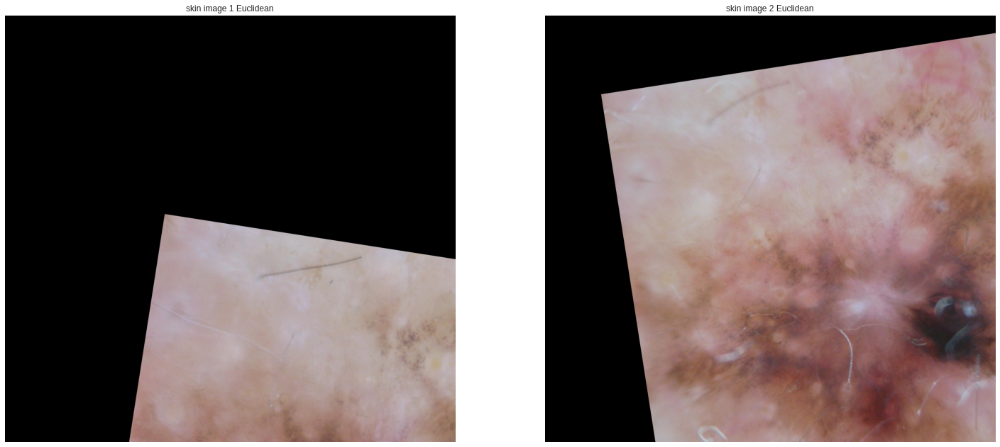

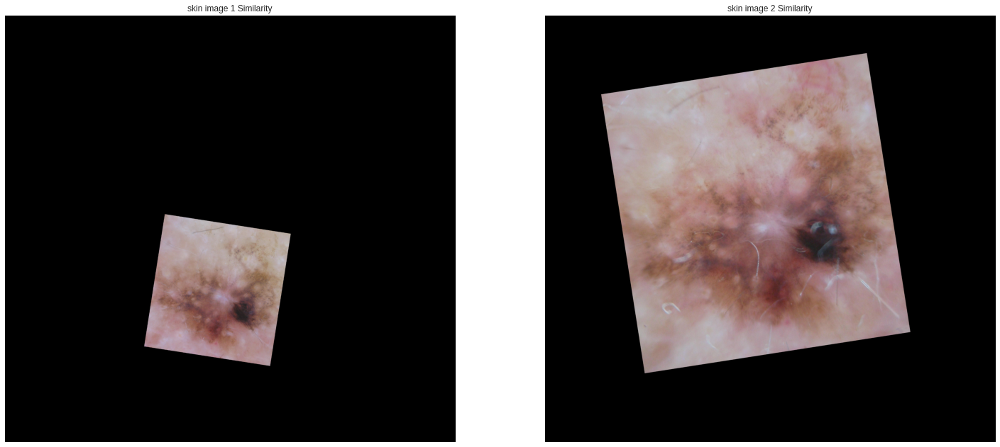

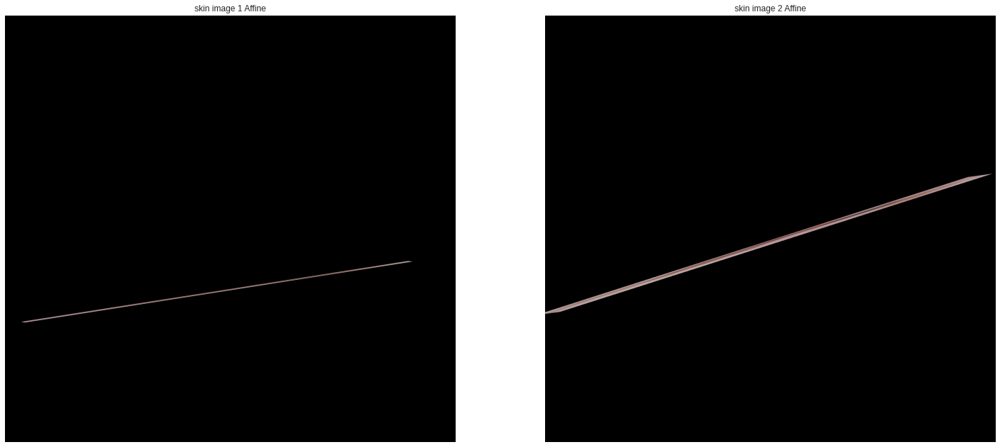

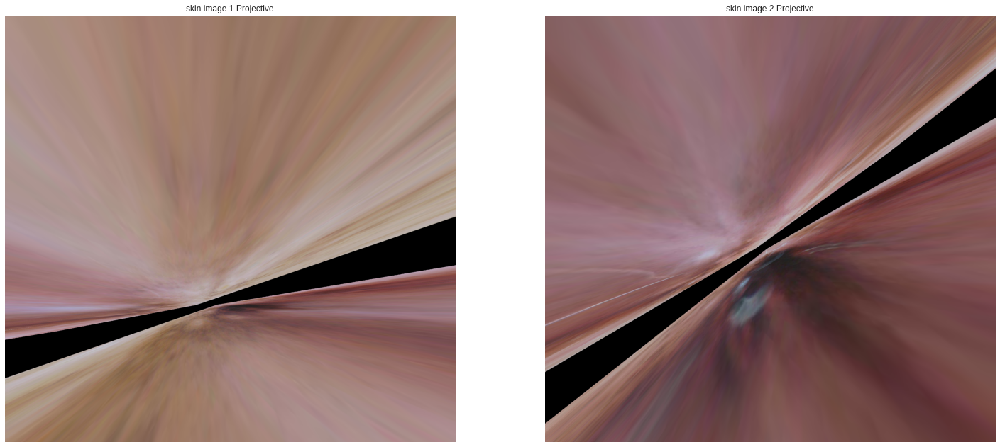

In [ ]:
sk_1_2_E = computeHomography(cv2.KeyPoint.convert(keypoints1),cv2.KeyPoint.convert(keypoints2),'Euclidean')
sk_2_1_E = computeHomography(cv2.KeyPoint.convert(keypoints2),cv2.KeyPoint.convert(keypoints1),'Euclidean')

sk_1_2_S = computeHomography(cv2.KeyPoint.convert(keypoints1),cv2.KeyPoint.convert(keypoints2),'Similarity')
sk_2_1_S = computeHomography(cv2.KeyPoint.convert(keypoints2),cv2.KeyPoint.convert(keypoints1),'Similarity')

sk_1_2_A = computeHomography(cv2.KeyPoint.convert(keypoints1),cv2.KeyPoint.convert(keypoints2),'Affine')
sk_2_1_A = computeHomography(cv2.KeyPoint.convert(keypoints2),cv2.KeyPoint.convert(keypoints1),'Affine')

sk_1_2_P = computeHomography(cv2.KeyPoint.convert(keypoints1),cv2.KeyPoint.convert(keypoints2),'Projective')
sk_2_1_P = computeHomography(cv2.KeyPoint.convert(keypoints2),cv2.KeyPoint.convert(keypoints1),'Projective')

sk_img_1_2_E = cv2.warpPerspective(skin1, sk_1_2_E, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_E = cv2.warpPerspective(skin2, sk_2_1_E, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_S = cv2.warpPerspective(skin1, sk_1_2_S, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_S = cv2.warpPerspective(skin2, sk_2_1_S, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_A = cv2.warpPerspective(skin1, sk_1_2_A, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_A = cv2.warpPerspective(skin2, sk_2_1_A, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_P = cv2.warpPerspective(skin1, sk_1_2_P, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_P = cv2.warpPerspective(skin2, sk_2_1_P, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(skin1, cv2.COLOR_BGR2RGB))
plt.title('skin image 1'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(skin2, cv2.COLOR_BGR2RGB))
plt.title('skin image 2'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_E, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Euclidean'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_E, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Euclidean'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_S, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Similarity'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_S, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Similarity'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_A, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Affine'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_A, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Affine'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_P, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Projective'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_P, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Projective'), plt.xticks([]), plt.yticks([])


$\color{red}{\text{As in these images the features were not very distincts most of the model of homography function did not work well}}$
$\color{red}{\text{Here we used our computeHomography function on both of the skin imaes skin1 and skin2 and we found a lot of outliers are present in the resultant images}}$

## You should notice that you have outliers when you compute the Homography.

Implement RANSAC function and recompute all the Homographies using it.

Finally Warp one of the images and compare your results with the ones obtained using opencv functions.

#Ransac


In [ ]:
THRESHOLD = 0.8
NUM_ITERS = 100

$\color{red}{\text{
Creating a point map of matches between the two images. Here the matches are "best_match" which is the match from our sift_match function.}}$

In [ ]:
point_map =([
        [keypoints1[match.queryIdx].pt[0],
         keypoints1[match.queryIdx].pt[1],
         keypoints2[match.trainIdx].pt[0],
         keypoints2[match.trainIdx].pt[1]] for match in best_match
         ])

In [ ]:
point_map

$\color{red}{\text{Returns the geometric distance between a pair of points given the homography "h_o"}}$

In [ ]:
def dist(pair, h_o):
  
    # points in homogeneous coordinates
    p1 = np.array([pair[0], pair[1], 1])
    p2 = np.array([pair[2], pair[3], 1])

    p2_estimate = np.dot(h_o, np.transpose(p1))
    p2_estimate = (1 / p2_estimate[2]) * p2_estimate

    return np.linalg.norm(np.transpose(p2) - p2_estimate)

$\color{red}{\text{Here we are taking the point map, model as the arg. Here the threshold is 0.8 and num of iteration is 100.}}$
$\color{red}{\text{Here we have converted pairs we get from point maps as nd array of x1,y1 and x2,y2 as an input of our homography funtion.}}$

$\color{red}{\text{In the Ransac function it randomly selects the minimum no_of_points to determine the model parameters. After that Determine how many points from the set of all points fit}}$
$\color{red}{\text{with a predefined tolerance. If the num of inlier/total num of points != threshold then we re compute the no_of_points for the model parameter }}$

In [ ]:
def RANSAC(point_map,model,threshold=THRESHOLD, verbose=True):
  
    if verbose:
        print(f'Running RANSAC with {len(point_map)} points...')
    bestInliers = set()
    homography = None
    for i in range(NUM_ITERS):
        # randomly choose 4 points from the matrix to compute the homography
        
        pairs = [point_map[i] for i in np.random.choice(len(point_map), 4)]

        features1_x = [value[0] for value in pairs]
        features1_y = [value[1] for value in pairs]
        features2_x = [value[2] for value in pairs]
        features2_y = [value[3] for value in pairs]

        x1=np.array(features1_x)
        y1=np.array(features1_y)
        x2=np.array(features2_x)
        y2=np.array(features2_y)
        x1=x1[:,None]
        y1=y1[:,None]
        x2=x2[:,None]
        y2=y2[:,None]

        features_1=np.concatenate((x1,y1), axis=1)
        features_2=np.concatenate((x2,y2), axis=1)
        features_1=np.array( features_1)
        features_2=np.array( features_2)

        h_o =  computeHomography(features_1, features_2, model)
        inliers = {(c[0], c[1], c[2], c[3])
                   for c in point_map if dist(c, h_o) < 500}
                   
        #checking the iteration
        if verbose:
            print(f'\x1b[2K\r└──> iteration {i + 1}/{NUM_ITERS} ' +
                  f'\t{len(inliers)} inlier' + ('s ' if len(inliers) != 1 else ' ') +
                  f'\tbest: {len(bestInliers)}', end='')

        if len(inliers) > len(bestInliers):
            bestInliers = inliers
            homography = h_o
            if len(bestInliers) > (len(point_map) * threshold):
                break

    if verbose:
        print(f'\nNum matches: {len(point_map)}')
        print(f'Num inliers: {len(bestInliers)}')
        print(f'Min inliers: {len(point_map) * threshold}')

    return homography, bestInliers

Running RANSAC with 27 points...
└──> iteration 2/100 	22 inliers 	best: 2
Num matches: 27
Num inliers: 22
Min inliers: 21.6
Running RANSAC with 27 points...
└──> iteration 1/100 	22 inliers 	best: 0
Num matches: 27
Num inliers: 22
Min inliers: 21.6
Running RANSAC with 27 points...
└──> iteration 1/100 	22 inliers 	best: 0
Num matches: 27
Num inliers: 22
Min inliers: 21.6
Running RANSAC with 27 points...
└──> iteration 5/100 	22 inliers 	best: 18
Num matches: 27
Num inliers: 22
Min inliers: 21.6


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:118: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


(Text(0.5, 1.0, 'skin image 2 Projective'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

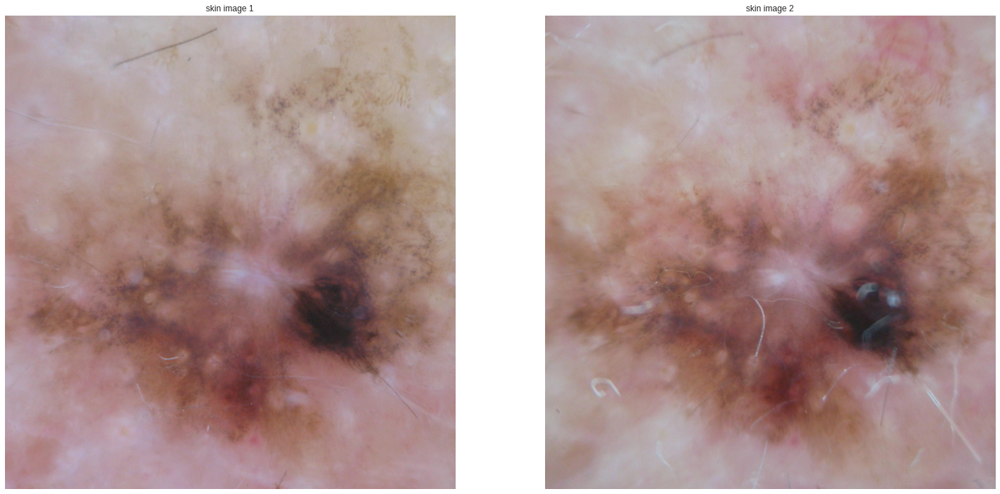

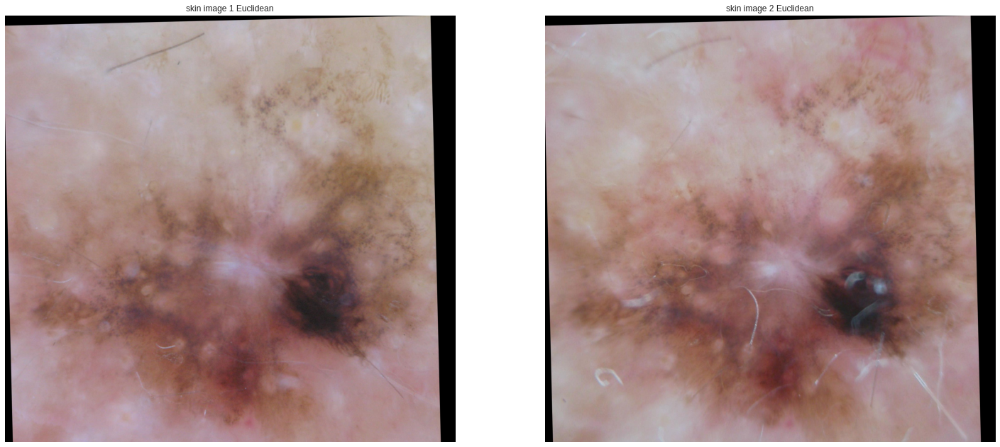

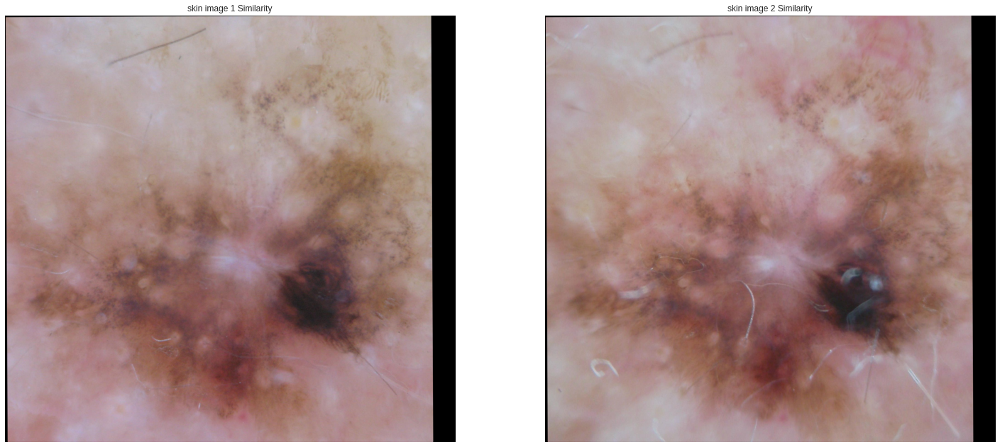

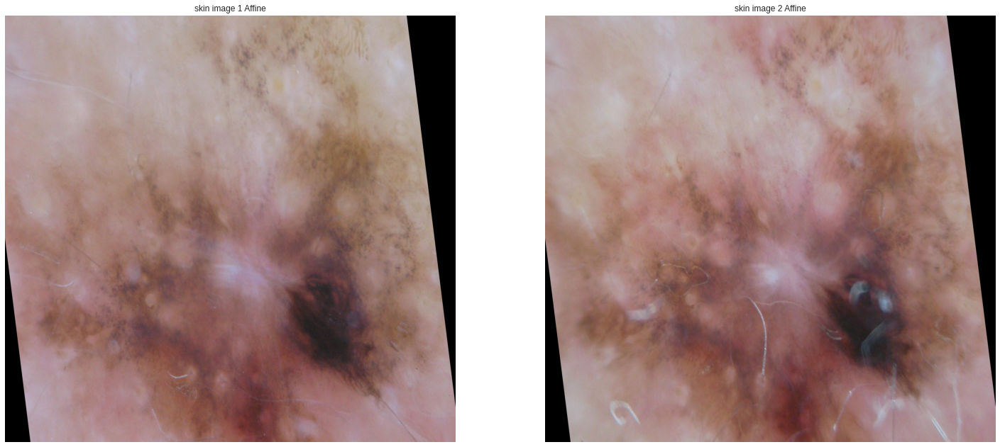

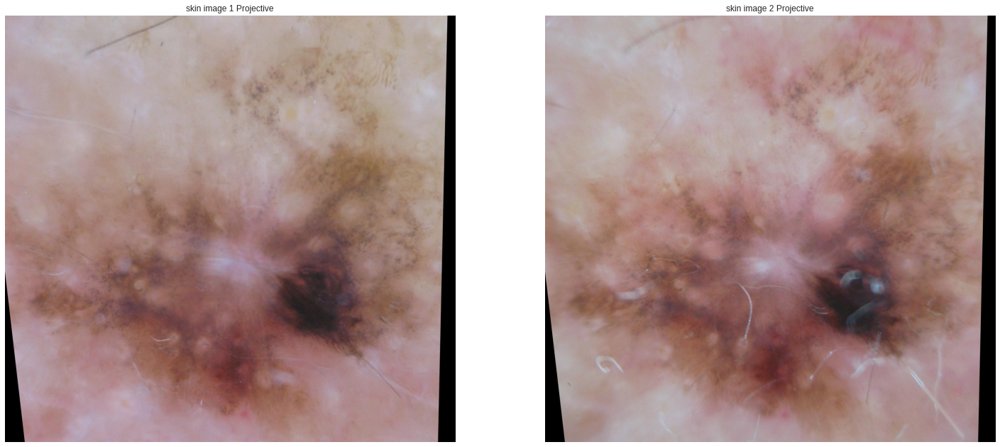

In [ ]:
homography_E,inlpoints= RANSAC(point_map,'Euclidean',verbose=True)

homography_S,inlpoints= RANSAC(point_map,'Similarity',verbose=True)

homography_A,inlpoints= RANSAC(point_map,'Affine',verbose=True)

homography_P,inlpoints= RANSAC(point_map,'Projective',verbose=True)


sk_img_1_2_E = cv2.warpPerspective(skin1, homography_E, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_E = cv2.warpPerspective(skin2, homography_E, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_S = cv2.warpPerspective(skin1, homography_S, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_S = cv2.warpPerspective(skin2, homography_S, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_A = cv2.warpPerspective(skin1, homography_A, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_A = cv2.warpPerspective(skin2, homography_A, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

sk_img_1_2_P = cv2.warpPerspective(skin1, homography_P, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)
sk_img_2_1_P = cv2.warpPerspective(skin2, homography_P, (skin1.shape[0],skin1.shape[1]), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(skin1, cv2.COLOR_BGR2RGB))
plt.title('skin image 1'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(skin2, cv2.COLOR_BGR2RGB))
plt.title('skin image 2'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_E, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Euclidean'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_E, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Euclidean'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_S, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Similarity'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_S, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Similarity'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_A, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Affine'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_A, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Affine'), plt.xticks([]), plt.yticks([])

plt.figure(figsize=(25,25))

plt.subplot(121)
plt.imshow(cv2.cvtColor(sk_img_1_2_P, cv2.COLOR_BGR2RGB))
plt.title('skin image 1 Projective'), plt.xticks([]), plt.yticks([])

plt.subplot(122)
plt.imshow(cv2.cvtColor(sk_img_2_1_P, cv2.COLOR_BGR2RGB))
plt.title('skin image 2 Projective'), plt.xticks([]), plt.yticks([])

$\color{red}{\text{We have seen that there can be some possible errors while matching which may affect the result.}}$

$\color{red}{\text{To solve this problem, Here we computed the homography with ourRANSAC and our homography function.}}$
$\color{red}{\text{As the RANSAC allows us to compute the homography with inliers instead of the outliers we can see in the figures that the homography with RANSAC improved the}}$
$\color{red}{\text{Increasing the threshold value accepted less inliers}}$
$\color{red}{\text{all the transformation(Eucledean,Similarity,Affine,Projective where the results of computing the homography without RANSAC was not good.}}$


## Congratulations!
In this lab you:
- tested SIFT Algorithm
- implemented homography computation

Submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.